In [1]:
import numpy as np
import pandas as pd
from pandas import DataFrame,Series
import json
import random
import requests
import datetime
from pyecharts.charts import Bar
from pyecharts.globals import ThemeType
from pyecharts import options as opts

In [2]:
data = pd.read_csv('ximalaya_0813_one.csv')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 296190 entries, 0 to 296189
Data columns (total 14 columns):
Unnamed: 0     296190 non-null int64
albumId        296190 non-null int64
anchorName     296190 non-null object
category       296190 non-null object
coverPath      296190 non-null object
isFinished     296190 non-null int64
isPaid         296190 non-null bool
link           296190 non-null object
playCount      296190 non-null int64
subcategory    296190 non-null object
title          296189 non-null object
trackCount     296190 non-null int64
uid            296190 non-null int64
vipType        296190 non-null int64
dtypes: bool(1), int64(7), object(6)
memory usage: 29.7+ MB


In [3]:
#剔除其中albumId重复的

data_unique = data.drop_duplicates(subset='albumId')
data_unique.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 191277 entries, 0 to 296161
Data columns (total 14 columns):
Unnamed: 0     191277 non-null int64
albumId        191277 non-null int64
anchorName     191277 non-null object
category       191277 non-null object
coverPath      191277 non-null object
isFinished     191277 non-null int64
isPaid         191277 non-null bool
link           191277 non-null object
playCount      191277 non-null int64
subcategory    191277 non-null object
title          191276 non-null object
trackCount     191277 non-null int64
uid            191277 non-null int64
vipType        191277 non-null int64
dtypes: bool(1), int64(7), object(6)
memory usage: 20.6+ MB


In [4]:
#由于保存到excel，Unnamed: 0 这一列是无效的，和coverPath一起剔除掉

data_unique.columns

Index(['Unnamed: 0', 'albumId', 'anchorName', 'category', 'coverPath',
       'isFinished', 'isPaid', 'link', 'playCount', 'subcategory', 'title',
       'trackCount', 'uid', 'vipType'],
      dtype='object')

In [5]:
data_unique = data_unique[['albumId', 'anchorName', 'category',
       'isFinished', 'isPaid', 'link', 'playCount', 'subcategory', 'title',
       'trackCount', 'uid', 'vipType']]
data_unique.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 191277 entries, 0 to 296161
Data columns (total 12 columns):
albumId        191277 non-null int64
anchorName     191277 non-null object
category       191277 non-null object
isFinished     191277 non-null int64
isPaid         191277 non-null bool
link           191277 non-null object
playCount      191277 non-null int64
subcategory    191277 non-null object
title          191276 non-null object
trackCount     191277 non-null int64
uid            191277 non-null int64
vipType        191277 non-null int64
dtypes: bool(1), int64(6), object(5)
memory usage: 17.7+ MB


In [7]:
#增加一列：平均一集的播放数
data_unique.trackCount[data_unique['trackCount'] == 0] = 1  #把trackCount为0的异常值替换成1

data_unique['avg_playcount'] = data_unique['playCount']/data_unique['trackCount']
data_unique.head()

/Users/shenxibo/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


,albumId,anchorName,category,isFinished,isPaid,link,playCount,subcategory,title,trackCount,uid,vipType,avg_playcount
0,19383749,一刀苏苏,youshengshu,1,False,/youshengshu/19383749/,540780885,yanqing,王的女人谁敢动｜爆笑古言穿越（免费双播精品）,714,30913215,0,757396.197479
1,7949508,风吹夜未央,youshengshu,0,False,/youshengshu/7949508/,446717926,yanqing,神秘男神，求休战。作者安缨,3440,58086964,0,129859.862209
2,3504297,CV马蹄酥,youshengshu,2,False,/youshengshu/3504297/,344714296,yanqing,相府嫡女,765,37418520,0,450606.922876
3,15398323,红颜醉送,youshengshu,1,False,/youshengshu/15398323/,299917130,yanqing,总裁爹地很宠妻（都市言情文）,1402,104783015,0,213920.920114
4,16917799,璇儿是宝妈,youshengshu,1,False,/youshengshu/16917799/,281154116,yanqing,抢婚成爱（高甜宠妻）,755,98966642,0,372389.557616


In [8]:
#单集播放量前20
rank_avg_playcount = data_unique.sort_values(by='avg_playcount',ascending=False)[['anchorName','playCount','avg_playcount','title']][:20]
rank_avg_playcount


,anchorName,playCount,avg_playcount,title
93031,艺休哥,622137565,1.244275e+08,【艺休哥】儿童歇后语故事
155254,超级制作,3329144148,7.566237e+07,晓说2018
88033,艺休哥,1204874461,5.238585e+07,【艺休哥】儿童谚语故事
155270,精选FM,27401181,2.740118e+07,xiaoshuo2017
157896,喜马创造,1110446591,2.582434e+07,晓说2017
157895,舍得智慧讲堂,1280243572,2.370821e+07,《舍得智慧讲堂》第二季中国智慧
155255,观复马未都,2335983894,1.717635e+07,观复嘟嘟
95032,艺休哥,238815351,1.256923e+07,【艺休哥】讲儿童艺术故事
94033,艺休哥,57515430,1.150309e+07,【艺休哥】儿童学宋词
72175,超级制作,362736740,9.300942e+06,写信告诉我 | 第二季


In [154]:
bar = Bar(init_opts=opts.InitOpts(theme=ThemeType.LIGHT))
bar.add_xaxis(rank_avg_playcount['title'].tolist())
#bar.add_yaxis("专辑总播放量",rank_avg_playcount['playCount'].tolist())
bar.add_yaxis("平均一集播放量", rank_avg_playcount['avg_playcount'].tolist())
bar.reversal_axis()
bar.set_global_opts(title_opts=opts.TitleOpts(title="前20专辑数量分布", subtitle="avg_playCount"))
bar.set_series_opts(label_opts=opts.LabelOpts(is_show=True, position='right'))

# render 会生成本地 HTML 文件，默认会在当前目录生成 render.html 文件
# 也可以传入路径参数，如 bar.render("mycharts.html")
bar.render_notebook()

In [16]:
#专辑播放数
rank_playCount = data_unique.sort_values(by='playCount',ascending=False)[['anchorName','playCount','avg_playcount','title']]
rank_playCount.head(10)


,anchorName,playCount,avg_playcount,title
66755,采采,5154443062,6.099933e+06,段子来了
2000,有声的紫襟,3556694820,3.139183e+06,摸金天师【紫襟演播】
155254,超级制作,3329144148,7.566237e+07,晓说2018
4000,丸子,2666948808,1.286517e+06,超品相师（丸子演播）
155255,观复马未都,2335983894,1.717635e+07,观复嘟嘟
4010,阿陈书场,1536535716,2.466349e+06,首席医官
88032,米小圈,1397667508,5.438395e+06,米小圈上学记：一二三年级
157895,舍得智慧讲堂,1280243572,2.370821e+07,《舍得智慧讲堂》第二季中国智慧
165088,上官文露,1274562965,2.288264e+06,上官文露读书会
88033,艺休哥,1204874461,5.238585e+07,【艺休哥】儿童谚语故事


In [17]:
bar = Bar(init_opts=opts.InitOpts(theme=ThemeType.LIGHT))
bar.add_xaxis(rank_playCount['title'].tolist())
bar.add_yaxis("专辑总播放量",rank_playCount['playCount'].tolist())
#bar.add_yaxis("平均一集播放量", top20['avg_playcount'].tolist())

bar.set_global_opts(title_opts=opts.TitleOpts(title="前20专辑数量分布", subtitle="playCount"),
                   datazoom_opts=[opts.DataZoomOpts(), opts.DataZoomOpts(type_="inside")])
bar.set_series_opts(label_opts=opts.LabelOpts(is_show=False))

bar.render_notebook()

In [20]:
#不同category分类的专辑数量

data_unique.groupby(by='category').count().sort_values(by='albumId',ascending=False)

,albumId,anchorName,isFinished,isPaid,link,playCount,subcategory,title,trackCount,uid,vipType,avg_playcount
category,,,,,,,,,,,,
yinyue,19703,19703,19703,19703,19703,19703,19703,19703,19703,19703,19703,19703
jiaoyu,19304,19304,19304,19304,19304,19304,19304,19304,19304,19304,19304,19304
renwen,16580,16580,16580,16580,16580,16580,16580,16580,16580,16580,16580,16580
youshengshu,16037,16037,16037,16037,16037,16037,16037,16037,16037,16037,16037,16037
waiyu,15347,15347,15347,15347,15347,15347,15347,15346,15347,15347,15347,15347
ertong,14981,14981,14981,14981,14981,14981,14981,14981,14981,14981,14981,14981
shangye,10051,10051,10051,10051,10051,10051,10051,10051,10051,10051,10051,10051
lishi,9968,9968,9968,9968,9968,9968,9968,9968,9968,9968,9968,9968
yule,9893,9893,9893,9893,9893,9893,9893,9893,9893,9893,9893,9893


In [55]:
category_rank = data_unique.groupby(by='category').count().sort_values(by='albumId',ascending=False)

bar = Bar(init_opts=opts.InitOpts(theme=ThemeType.DARK))
bar.add_xaxis(category_rank.index.tolist())
bar.add_yaxis("专辑数量",category_rank['albumId'].tolist())
bar.reversal_axis()
bar.set_global_opts(title_opts=opts.TitleOpts(title="不同分类的专辑数量", subtitle="category"),)
bar.set_series_opts(label_opts=opts.LabelOpts(is_show=False))

bar.render_notebook()

In [111]:
cate_list = []
for i in range(len(category_rank)):
    temp_dict = {'value':category_rank.iloc[i]['albumId'], 'name':category_rank.index[i]}
    cate_list.append(temp_dict)
    
cate_list

[{'value': 19703, 'name': 'yinyue'},
 {'value': 19304, 'name': 'jiaoyu'},
 {'value': 16580, 'name': 'renwen'},
 {'value': 16037, 'name': 'youshengshu'},
 {'value': 15347, 'name': 'waiyu'},
 {'value': 14981, 'name': 'ertong'},
 {'value': 10051, 'name': 'shangye'},
 {'value': 9968, 'name': 'lishi'},
 {'value': 9893, 'name': 'yule'},
 {'value': 8775, 'name': 'qinggan'},
 {'value': 8251, 'name': 'jiankang'},
 {'value': 6648, 'name': 'shishang'},
 {'value': 4890, 'name': 'toutiao'},
 {'value': 4821, 'name': 'lvyou'},
 {'value': 4768, 'name': 'erciyuan'},
 {'value': 4207, 'name': 'xiqu'},
 {'value': 4171, 'name': 'guangbojv'},
 {'value': 3361, 'name': 'yingshi'},
 {'value': 3148, 'name': 'keji'},
 {'value': 2994, 'name': 'xiangsheng'},
 {'value': 2121, 'name': 'diantai'},
 {'value': 1258, 'name': 'qiche'}]

In [119]:
cate_list = [{'value': 19703, 'name': 'yinyue'},
 {'value': 19304, 'name': 'jiaoyu'},
 {'value': 16580, 'name': 'renwen'},
 {'value': 16037, 'name': 'youshengshu'},
 {'value': 15347, 'name': 'waiyu'},
 {'value': 14981, 'name': 'ertong'},
 {'value': 10051, 'name': 'shangye'},
 {'value': 9968, 'name': 'lishi'},
 {'value': 9893, 'name': 'yule'},
 {'value': 8775, 'name': 'qinggan'},
 {'value': 8251, 'name': 'jiankang'},
 {'value': 6648, 'name': 'shishang'},
 {'value': 4890, 'name': 'toutiao'},
 {'value': 4821, 'name': 'lvyou'},
 {'value': 4768, 'name': 'erciyuan'},
 {'value': 4207, 'name': 'xiqu'},
 {'value': 4171, 'name': 'guangbojv'},
 {'value': 3361, 'name': 'yingshi'},
 {'value': 3148, 'name': 'keji'},
 {'value': 2994, 'name': 'xiangsheng'},
 {'value': 2121, 'name': 'diantai'},
 {'value': 1258, 'name': 'qiche'}]
c = TreeMap(init_opts=opts.InitOpts())
c.add('树形图', cate_list, label_opts=opts.LabelOpts(position='inside', is_show=True, ))
c.set_global_opts(title_opts=opts.TitleOpts(title="TreeMap-官方示例"))
#c.set_series_opts(label_opts=opts.LabelOpts(is_show=False))
c.render_notebook()

In [56]:
#subcategory子标题太多，需要转化成中文

url_category = 'https://www.ximalaya.com/revision/category/allCategoryInfo'
Headers = {'User-Agent': 'Mozilla/5.0 (Macintosh; Intel Mac OS X 10_14_1) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/75.0.3770.142 Safari/537.36'}
r = requests.get(url_category, headers = Headers)
json.loads(r.text)['data']
category = json.loads(r.text)['data']

#输出总目录页面的json数据
category


[{'id': 1,
  'name': '有声小说',
  'position': 1,
  'groupType': 1,
  'displayStatus': 1,
  'categories': [{'id': 3,
    'categoryType': 0,
    'displayStatus': 1,
    'displayName': '有声书',
    'link': '/youshengshu/',
    'name': 'youshengshu',
    'picPath': '//imagev2.xmcdn.com/group42/M07/B5/00/wKgJ9Fq16BSishjCAAAc2ts5ctw377.png',
    'pinyin': 'youshengshu',
    'position': 1,
    'subcategories': [{'id': 3769,
      'categoryId': 3,
      'position': 1,
      'metadataId': 226,
      'metadataValue': '言情',
      'code': 'yanqing',
      'displayStatus': 1,
      'link': '/youshengshu/yanqing/',
      'displayValue': '言情',
      'metas': [],
      'isKeyword': False},
     {'id': 3776,
      'categoryId': 3,
      'position': 1,
      'metadataId': 225,
      'metadataValue': '文学',
      'code': 'wenxue',
      'displayStatus': 1,
      'link': '/youshengshu/wenxue/',
      'displayValue': '文学',
      'metas': [],
      'isKeyword': False},
     {'id': 3767,
      'categoryId': 3,
   

In [43]:
subcate_cnname_list

{'yanqing': {'level_one': '有声小说',
  'level_two': '有声书',
  'level_three': '言情',
  'category': 'youshengshu',
  'subcategory': 'yanqing'},
 'wenxue': {'level_one': '知识',
  'level_two': '人文',
  'level_three': '文学',
  'category': 'renwen',
  'subcategory': 'wenxue'},
 'xuanyi': {'level_one': '特色',
  'level_two': '广播剧',
  'level_three': '悬疑',
  'category': 'guangbojv',
  'subcategory': 'xuanyi'},
 'shenghuo': {'level_one': '有声小说',
  'level_two': '有声书',
  'level_three': '生活',
  'category': 'youshengshu',
  'subcategory': 'shenghuo'},
 'dushi': {'level_one': '特色',
  'level_two': '广播剧',
  'level_three': '都市',
  'category': 'guangbojv',
  'subcategory': 'dushi'},
 'jiaocai': {'level_one': '有声小说',
  'level_two': '有声书',
  'level_three': '教材',
  'category': 'youshengshu',
  'subcategory': 'jiaocai'},
 'huanxiang': {'level_one': '有声小说',
  'level_two': '有声书',
  'level_three': '幻想',
  'category': 'youshengshu',
  'subcategory': 'huanxiang'},
 'jingdian': {'level_one': '知识',
  'level_two': '人文',
  'le

In [48]:
#转化subcategory为中文名

def change_cn_name(en_name):
    return subcate_cnname_list[en_name]['level_three']

# def change_cn_catename(en_name):
#     return subcate_cnname_list[en_name]['level_two']

# change_cn_catename('reci81')

'汽车'

In [50]:
data_unique['sub_cn_name'] = data_unique['subcategory'].apply(change_cn_name)

data_unique.head()

,albumId,anchorName,category,isFinished,isPaid,link,playCount,subcategory,title,trackCount,uid,vipType,avg_playcount,sub_cn_name
0,19383749,一刀苏苏,youshengshu,1,False,/youshengshu/19383749/,540780885,yanqing,王的女人谁敢动｜爆笑古言穿越（免费双播精品）,714,30913215,0,757396.197479,言情
1,7949508,风吹夜未央,youshengshu,0,False,/youshengshu/7949508/,446717926,yanqing,神秘男神，求休战。作者安缨,3440,58086964,0,129859.862209,言情
2,3504297,CV马蹄酥,youshengshu,2,False,/youshengshu/3504297/,344714296,yanqing,相府嫡女,765,37418520,0,450606.922876,言情
3,15398323,红颜醉送,youshengshu,1,False,/youshengshu/15398323/,299917130,yanqing,总裁爹地很宠妻（都市言情文）,1402,104783015,0,213920.920114,言情
4,16917799,璇儿是宝妈,youshengshu,1,False,/youshengshu/16917799/,281154116,yanqing,抢婚成爱（高甜宠妻）,755,98966642,0,372389.557616,言情


In [54]:
#对外语类进行分析

waiyu_data = data_unique[data_unique.category=='waiyu']

waiyu_data.groupby(by='sub_cn_name').count()

,albumId,anchorName,category,isFinished,isPaid,link,playCount,subcategory,title,trackCount,uid,vipType,avg_playcount
sub_cn_name,,,,,,,,,,,,,
付费专区,3,3,3,3,3,3,3,3,3,3,3,3,3
俄语,520,520,520,520,520,520,520,520,520,520,520,520,520
入门,333,333,333,333,333,333,333,333,333,333,333,333,333
其他语言,650,650,650,650,650,650,650,650,649,650,650,650,650
口语,574,574,574,574,574,574,574,574,574,574,574,574,574
名著,913,913,913,913,913,913,913,913,913,913,913,913,913
少儿,180,180,180,180,180,180,180,180,180,180,180,180,180
影视,810,810,810,810,810,810,810,810,810,810,810,810,810
德语,953,953,953,953,953,953,953,953,953,953,953,953,953


In [57]:
waiyu_rank = waiyu_data.groupby(by='sub_cn_name').count().sort_values(by='albumId',ascending=False)

bar = Bar(init_opts=opts.InitOpts(theme=ThemeType.DARK))
bar.add_xaxis(waiyu_rank.index.tolist())
bar.add_yaxis("英语专辑数量",waiyu_rank['albumId'].tolist())
bar.reversal_axis()
bar.set_global_opts(title_opts=opts.TitleOpts(title="不同分类的专辑数量", subtitle="category"),)
bar.set_series_opts(label_opts=opts.LabelOpts(is_show=False))

bar.render_notebook()

In [75]:
#TreeMap：矩形树图
from pyecharts.charts import Page, TreeMap

waiyu_list = []
for i in range(len(waiyu_rank)):
    temp_dict = {'value':waiyu_rank.iloc[i]['albumId'], 'name':waiyu_rank.index[i]}
    waiyu_list.append(temp_dict)
    
waiyu_list

[{'value': 1000, 'name': '法语'},
 {'value': 1000, 'name': '日语'},
 {'value': 1000, 'name': '韩语'},
 {'value': 997, 'name': '英语'},
 {'value': 953, 'name': '德语'},
 {'value': 949, 'name': '演讲'},
 {'value': 913, 'name': '名著'},
 {'value': 865, 'name': '考试'},
 {'value': 810, 'name': '影视'},
 {'value': 760, 'name': '美文'},
 {'value': 715, 'name': '教材'},
 {'value': 675, 'name': '脱口秀'},
 {'value': 650, 'name': '其他语言'},
 {'value': 600, 'name': '词汇'},
 {'value': 574, 'name': '口语'},
 {'value': 520, 'name': '俄语'},
 {'value': 452, 'name': '西班牙语'},
 {'value': 378, 'name': '职场'},
 {'value': 333, 'name': '入门'},
 {'value': 330, 'name': '资讯趣闻'},
 {'value': 257, 'name': '意大利语'},
 {'value': 243, 'name': '旅游'},
 {'value': 180, 'name': '少儿'},
 {'value': 103, 'name': '泰语'},
 {'value': 87, 'name': '葡萄牙语'},
 {'value': 3, 'name': '付费专区'}]

In [85]:
test_data = [
       {'value': 1000, 'name': '法语'},
 {'value': 1000, 'name': '日语'},
 {'value': 1000, 'name': '韩语'},
 {'value': 997, 'name': '英语'},
 {'value': 953, 'name': '德语'},
 {'value': 949, 'name': '演讲'},
 {'value': 913, 'name': '名著'},
 {'value': 865, 'name': '考试'},
 {'value': 810, 'name': '影视'},
 {'value': 760, 'name': '美文'},
 {'value': 715, 'name': '教材'},
 {'value': 675, 'name': '脱口秀'},
 {'value': 650, 'name': '其他语言'},
 {'value': 600, 'name': '词汇'},
 {'value': 574, 'name': '口语'},
 {'value': 520, 'name': '俄语'},
 {'value': 452, 'name': '西班牙语'},
 {'value': 378, 'name': '职场'},
 {'value': 333, 'name': '入门'},
 {'value': 330, 'name': '资讯趣闻'},
 {'value': 257, 'name': '意大利语'},
 {'value': 243, 'name': '旅游'},
 {'value': 180, 'name': '少儿'},
 {'value': 103, 'name': '泰语'},
 {'value': 87, 'name': '葡萄牙语'},
 {'value': 3, 'name': '付费专区'}
]

In [109]:
c = TreeMap()
c.add('树形图', test_data, label_opts=opts.LabelOpts(position='inside'))
c.set_global_opts(title_opts=opts.TitleOpts(title="TreeMap-官方示例"))
c.render_notebook()



In [135]:
#对儿童类进行分析, 这次从总播放数来分析

ertong_data = data_unique[data_unique.category=='ertong']

t = ertong_data.groupby(by='sub_cn_name').avg_playcount.mean()

ertong_list = []
for i in range(len(t)):
    temp_dict = {'value':t.values[i], 'name':t.index[i]}
    ertong_list.append(temp_dict)
    
ertong_list

[{'value': 7268.74921369471, 'name': '健康'},
 {'value': 1679.6783681508043, 'name': '儿歌'},
 {'value': 38076.93630277329, 'name': '儿童教育'},
 {'value': 189560.60284920773, 'name': '儿童文学'},
 {'value': 4004.0951258027853, 'name': '动画'},
 {'value': 8560.696347809833, 'name': '名著'},
 {'value': 3720.0703579802835, 'name': '国学'},
 {'value': 157280.19105930245, 'name': '学科教育'},
 {'value': 286.12225172872536, 'name': '家教'},
 {'value': 44677.47249506408, 'name': '少儿国学'},
 {'value': 34978.042308345175, 'name': '少儿影视'},
 {'value': 293.5411428094243, 'name': '少儿艺术'},
 {'value': 31050.421852367384, 'name': '少儿英语'},
 {'value': 68495.82140396803, 'name': '少儿音乐'},
 {'value': 27794.540845899046, 'name': '故事'},
 {'value': 363.0808820109273, 'name': '教材'},
 {'value': 12536.797836034453, 'name': '母婴'},
 {'value': 22957.551254213548, 'name': '父母教育'},
 {'value': 1456.2237035823562, 'name': '科普'},
 {'value': 30030.804104622963, 'name': '科普百科'},
 {'value': 8031.945660764216, 'name': '绘本'},
 {'value': 65.568636460

In [137]:
c = TreeMap()
c.add('平均一集播放数', ertong_list, label_opts=opts.LabelOpts(position='inside'))
c.set_global_opts(title_opts=opts.TitleOpts(title="儿童类的平均每集播放数"))
c.render_notebook()

In [144]:
#对所有类进行分析, 这次从总播放数来分析

t = data_unique.groupby(by='category_cn').avg_playcount.mean()

cate_list = []
for i in range(len(t)):
    temp_dict = {'value':t.values[i], 'name':t.index[i]}
    cate_list.append(temp_dict)
    
cate_list

[{'value': 6986.501214987342, 'name': '二次元'},
 {'value': 18744.048375638842, 'name': '人文'},
 {'value': 4895.729012807353, 'name': '健康'},
 {'value': 43232.46412204291, 'name': '儿童'},
 {'value': 7939.08148750035, 'name': '历史'},
 {'value': 9664.124525454712, 'name': '商业'},
 {'value': 4182.846788260443, 'name': '外语'},
 {'value': 11055.449307952646, 'name': '头条'},
 {'value': 12070.331748522814, 'name': '娱乐'},
 {'value': 9493.980561138422, 'name': '广播剧'},
 {'value': 4950.316182764554, 'name': '影视'},
 {'value': 11015.262639426237, 'name': '情感'},
 {'value': 3943.654450402085, 'name': '戏曲'},
 {'value': 7561.629803521566, 'name': '教育'},
 {'value': 5410.145539374811, 'name': '旅游'},
 {'value': 1676.2473099351541, 'name': '时尚'},
 {'value': 16093.355741075744, 'name': '有声书'},
 {'value': 9988.833678434145, 'name': '汽车'},
 {'value': 801.488724684087, 'name': '电台'},
 {'value': 60583.29614531989, 'name': '相声'},
 {'value': 3718.4794773208914, 'name': '科技'},
 {'value': 13902.853576987012, 'name': '音乐'}]

In [145]:
c = TreeMap()
c.add('平均一集播放数', cate_list, label_opts=opts.LabelOpts(position='inside'))
c.set_global_opts(title_opts=opts.TitleOpts(title="所有类的平均每集播放数"))
c.render_notebook()

In [142]:
#把category改成中文显示
category_list = {'diantai':'电台',
 'erciyuan':'二次元',
 'ertong':'儿童',
 'guangbojv':'广播剧',
 'jiankang':'健康',
 'jiaoyu':'教育',
 'keji':'科技',
 'lishi':'历史',
 'lvyou':'旅游',
 'qiche':'汽车',
 'qinggan':'情感',
 'renwen':'人文',
 'shangye':'商业',
 'shishang':'时尚',
 'toutiao':'头条',
 'waiyu':'外语',
 'xiangsheng':'相声',
 'xiqu':'戏曲',
 'yingshi':'影视',
 'yinyue':'音乐',
 'youshengshu':'有声书',
 'yule':'娱乐'}

def category_cn(category):
    return category_list[category]

category_cn('yule')

'娱乐'

In [143]:
data_unique['category_cn'] = data_unique['category'].apply(category_cn)
data_unique.head()

,albumId,anchorName,category,isFinished,isPaid,link,playCount,subcategory,title,trackCount,uid,vipType,avg_playcount,sub_cn_name,category_cn
0,19383749,一刀苏苏,youshengshu,1,False,/youshengshu/19383749/,540780885,yanqing,王的女人谁敢动｜爆笑古言穿越（免费双播精品）,714,30913215,0,757396.197479,言情,有声书
1,7949508,风吹夜未央,youshengshu,0,False,/youshengshu/7949508/,446717926,yanqing,神秘男神，求休战。作者安缨,3440,58086964,0,129859.862209,言情,有声书
2,3504297,CV马蹄酥,youshengshu,2,False,/youshengshu/3504297/,344714296,yanqing,相府嫡女,765,37418520,0,450606.922876,言情,有声书
3,15398323,红颜醉送,youshengshu,1,False,/youshengshu/15398323/,299917130,yanqing,总裁爹地很宠妻（都市言情文）,1402,104783015,0,213920.920114,言情,有声书
4,16917799,璇儿是宝妈,youshengshu,1,False,/youshengshu/16917799/,281154116,yanqing,抢婚成爱（高甜宠妻）,755,98966642,0,372389.557616,言情,有声书


In [150]:
data_unique.groupby(by='category_cn').playCount.mean()

category_cn
二次元    7.005324e+04
人文     1.083399e+06
健康     2.361122e+05
儿童     1.549494e+06
历史     4.757033e+05
商业     7.302301e+05
外语     3.141679e+05
头条     8.569476e+05
娱乐     1.560285e+06
广播剧    1.011310e+05
影视     1.461893e+05
情感     8.007604e+05
戏曲     1.180513e+05
教育     2.764389e+05
旅游     1.473937e+05
时尚     6.259618e+04
有声书    3.802633e+06
汽车     7.665249e+05
电台     2.390623e+04
相声     4.154654e+06
科技     2.764897e+05
音乐     4.174347e+05
Name: playCount, dtype: float64

In [161]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('ggplot')

In [156]:
data_unique.describe()

,albumId,isFinished,playCount,trackCount,uid,vipType,avg_playcount
count,1.912770e+05,191277.000000,1.912770e+05,191277.000000,1.912770e+05,191277.000000,1.912770e+05
mean,1.236249e+07,0.331221,9.327766e+05,64.085985,6.084407e+07,0.028294,1.326947e+04
std,7.078749e+06,0.697978,2.323102e+07,186.391666,4.216236e+07,0.235884,3.885628e+05
min,3.400000e+01,0.000000,0.000000e+00,1.000000,1.000003e+06,0.000000,0.000000e+00
25%,5.886307e+06,0.000000,1.007000e+03,6.000000,2.636178e+07,0.000000,6.950000e+01
50%,1.266111e+07,0.000000,1.063700e+04,19.000000,5.498801e+07,0.000000,4.120000e+02
75%,1.823047e+07,0.000000,7.752100e+04,54.000000,9.267241e+07,0.000000,2.774892e+03
max,2.656135e+07,2.000000,5.154443e+09,15982.000000,1.843076e+08,2.000000,1.244275e+08


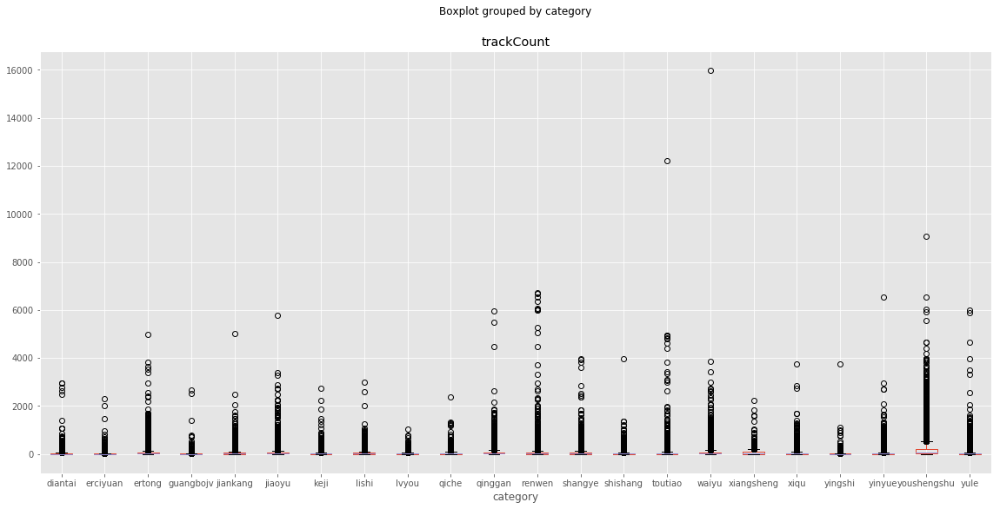

In [169]:
data_unique.boxplot(column='trackCount', by='category', figsize=(19,9))

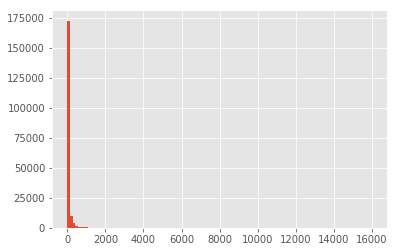

In [173]:
data_unique.trackCount.hist(bins=115)

In [191]:
#看看主播数据，只抽取部分，就从平均播放数排名靠前5k的专辑入手

top_5k = data_unique.drop_duplicates(subset='uid').sort_values(by='avg_playcount', ascending=False)[:5000]
top_5k

,albumId,anchorName,category,isFinished,isPaid,link,playCount,subcategory,title,trackCount,uid,vipType,avg_playcount,sub_cn_name,category_cn
88033,7623782,艺休哥,ertong,1,False,/ertong/7623782/,1204874461,ertongwenxue,【艺休哥】儿童谚语故事,23,76497173,0,5.238585e+07,儿童文学,儿童
52385,18826212,白百何_何她说,qinggan,1,False,/qinggan/18826212/,120809228,qinggan,第二季何她说,13,74969290,0,9.293018e+06,情感,情感
71175,13747126,惠普用星说,yule,1,False,/yule/13747126/,243723831,zhangzishi,惠普用星说,30,102703132,0,8.124128e+06,涨姿势,娱乐
12013,4514702,爱满天下Lily,youshengshu,0,False,/youshengshu/4514702/,7522929,sheke,持续收入的原则,1,25613843,0,7.522929e+06,社科,有声书
155256,15291104,朗读者,renwen,1,False,/renwen/15291104/,709305097,wenhua,朗读者 第二季,96,73899120,0,7.388595e+06,文化,人文
126890,16861863,冬吴同学会,shangye,1,False,/shangye/16861863/,713696313,shangjie,冬吴同学会|第二季,100,83432108,0,7.136963e+06,商界,商业
66757,11963058,吐槽大会,yule,1,False,/yule/11963058/,575147584,gaoxiao,吐槽大会,96,98990341,0,5.991121e+06,搞笑,娱乐
110617,23647583,档案春秋,lishi,0,False,/lishi/23647583/,135882273,zhengshi,市民朗读者：上海解放珍贵档案,23,174543810,0,5.907925e+06,正史,历史
88032,6233693,米小圈,ertong,2,False,/ertong/6233693/,1397667508,ertongwenxue,米小圈上学记：一二三年级,257,68394601,0,5.438395e+06,儿童文学,儿童
66767,21720393,留声机,yule,0,False,/toutiao/21720393/,81836173,gaoxiao,社会人初学指南,16,8609913,0,5.114761e+06,搞笑,娱乐


In [190]:
#从专辑页面获取主播信息

def getAnchorInfo(albumId):
    url = 'https://www.ximalaya.com/revision/album?albumId='
    r = requests.get(url + str(albumId), headers = Headers)
    j = json.loads(r.text)
    anchorTracksCount = j['data']['anchorInfo']['anchorTracksCount']
    anchorFansCount = j['data']['anchorInfo']['anchorFansCount']
    anchorAlbumsCount = j['data']['anchorInfo']['anchorAlbumsCount']
    anchorIntro = j['data']['anchorInfo']['personalIntroduction']
    anchorGrade = j['data']['anchorInfo']['anchorGrade']
    anchorId = j['data']['anchorInfo']['anchorId']
    anchorName = j['data']['anchorInfo']['anchorName']
    
    print(datetime.datetime.now().strftime('%H:%M:%S'),'---',
          {'anchorTracksCount':anchorTracksCount, 
            'anchorFansCount':anchorFansCount, 
            'anchorAlbumsCount':anchorAlbumsCount, 
            'anchorIntro':anchorIntro, 
            'anchorGrade':anchorGrade})
    return {'anchorId':anchorId,
            'anchorName':anchorName,
            'anchorTracksCount':anchorTracksCount, 
            'anchorFansCount':anchorFansCount, 
            'anchorAlbumsCount':anchorAlbumsCount, 
            'anchorIntro':anchorIntro, 
            'anchorGrade':anchorGrade}
    
getAnchorInfo(3493173)

14:44:04 --- {'anchorTracksCount': 2228, 'anchorFansCount': 5783239, 'anchorAlbumsCount': 17, 'anchorIntro': '这个星球上最爆笑糗事联播', 'anchorGrade': 14}


{'anchorId': 1000596,
 'anchorName': '糗事播报',
 'anchorTracksCount': 2228,
 'anchorFansCount': 5783239,
 'anchorAlbumsCount': 17,
 'anchorIntro': '这个星球上最爆笑糗事联播',
 'anchorGrade': 14}

In [224]:
#data_anchor = DataFrame()

#data_anchor = top_5k['albumId'].apply(getAnchorInfo)
#type(data_anchor)
# data_anchorInfo = DataFrame()

# for i in range(len(data_anchor)):
#     data_anchorInfo = data_anchorInfo.append(data_anchor.values[i],ignore_index=True)
#     print(data_anchor.values[i])


anchor_list = data_anchorInfo.sort_values(by='anchorFansCount',ascending=False)[:20]

bar = Bar(init_opts=opts.InitOpts(theme=ThemeType.DARK))
bar.add_xaxis(anchor_list['anchorName'].tolist())
bar.add_yaxis("主播的粉丝数",anchor_list['anchorFansCount'].tolist())
bar.reversal_axis()
bar.set_global_opts(title_opts=opts.TitleOpts(title="粉丝数前20名"))
bar.set_series_opts(label_opts=opts.LabelOpts(is_show=True, position='right'))

bar.render_notebook()

In [225]:
data_anchorInfo.describe()

,anchorAlbumsCount,anchorFansCount,anchorGrade,anchorId,anchorTracksCount
count,5000.000000,5.000000e+03,5000.000000,5.000000e+03,5000.000000
mean,19.458400,9.988987e+04,9.133800,4.727948e+07,633.242000
std,339.314876,3.595570e+05,2.754163,3.684084e+07,2929.319133
min,0.000000,1.000000e+00,-1.000000,1.000038e+06,0.000000
25%,2.000000,7.257000e+03,8.000000,1.693139e+07,33.000000
50%,5.000000,2.371800e+04,9.000000,4.000687e+07,119.000000
75%,10.000000,7.694800e+04,11.000000,7.135310e+07,426.000000
max,20564.000000,1.134569e+07,16.000000,1.817211e+08,138417.000000


In [226]:
data_anchorInfo.sort_values(by='anchorFansCount',ascending=False)

,anchorAlbumsCount,anchorFansCount,anchorGrade,anchorId,anchorIntro,anchorName,anchorTracksCount
10,70.0,11345693.0,16.0,1000202.0,郭德纲领衔德云社唯一授权音频平台,郭德纲相声,4553.0
4282,63.0,8309289.0,16.0,1266964.0,有声的紫襟,有声的紫襟,21702.0
2055,7.0,7230575.0,14.0,10936615.0,喜马拉雅FM自制频道,喜马创造,186.0
588,131.0,6107194.0,15.0,1000072.0,推荐收听《多人有声剧：百部小说里的中国史》,百家讲坛,2627.0
83,17.0,5783241.0,14.0,1000596.0,这个星球上最爆笑糗事联播,糗事播报,2228.0
1061,8.0,5454274.0,11.0,7931125.0,80后90后城市广播,都市夜归人,1515.0
779,12.0,5014993.0,12.0,3591379.0,每晚十点，治愈心情，陪你入睡,晚上十点,2082.0
2133,12.0,4385678.0,9.0,24137038.0,音乐,喜马拉雅音乐星球,504.0
50,46.0,3926317.0,15.0,91044493.0,喜马拉雅FM自制频道,超级制作,1569.0
2315,81.0,3610050.0,8.0,1017777.0,最新最火的新歌推荐,新歌速递,3303.0


In [278]:
#data_unique.isPaid.value_counts()  #付费比例

paid_rank = data_unique.groupby(by='category_cn').isPaid.value_counts()
type(paid_rank)

pandas.core.series.Series

In [280]:
paid_rank.index[2],paid_rank.values[0]

(('人文', False), 4764)

In [282]:
bar = Bar(init_opts=opts.InitOpts(theme=ThemeType.MACARONS,))
bar.add_xaxis(paid_rank.unstack().index.tolist())
bar.add_yaxis("免费数",paid_rank.unstack()[0].tolist(),color='yellow')
bar.add_yaxis("付费数",paid_rank.unstack()[1].tolist())
bar.reversal_axis()
bar.set_global_opts(title_opts=opts.TitleOpts(title="不同分类的免费和付费对比"))
bar.set_series_opts(label_opts=opts.LabelOpts(is_show=True, position='right'))

bar.render_notebook()

In [286]:
#付费的专辑分析

data_paid = data_unique[data_unique['isPaid']==True]
data_paid

,albumId,anchorName,category,isFinished,isPaid,link,playCount,subcategory,title,trackCount,uid,vipType,avg_playcount,sub_cn_name,category_cn
9,12083646,淘漉音乐,youshengshu,2,True,/youshengshu/12083646/,93777164,yanqing,神医嫡女（男女双播有声书）,773,36651710,2,121315,言情,有声书
19,2884894,寐尹,youshengshu,2,True,/youshengshu/2884894/,79649244,yanqing,第一庶女,264,3486637,2,301701,言情,有声书
29,22365086,一刀苏苏,youshengshu,1,True,/youshengshu/22365086/,77935250,yanqing,叔，你命中缺我|爆笑都市言情（一刀苏苏/一种侃侃精品双播）,731,30913215,2,106614,言情,有声书
37,14967392,聚力有声,youshengshu,2,True,/youshengshu/14967392/,72223955,yanqing,知否？知否？应是绿肥红瘦（赵丽颖冯绍峰主演电视剧）,303,108689369,2,238362,言情,有声书
40,15754471,君颜讲故事,youshengshu,2,True,/youshengshu/15754471/,68148446,yanqing,恰似你的温柔（多人小说剧）,729,37504890,2,93482,言情,有声书
50,4282103,半纸鸿鹊,youshengshu,2,True,/youshengshu/4282103/,64943356,yanqing,肥婆皇后（多人有声剧）,164,13120911,2,395996,言情,有声书
60,2850165,沈念如,youshengshu,2,True,/youshengshu/2850165/,59727913,yanqing,泪倾城·浅眸乱君颜,188,10024797,2,317701,言情,有声书
70,2953430,莫守陈规_风泠,youshengshu,2,True,/youshengshu/2953430/,47147357,yanqing,媚公卿,174,17337099,2,270961,言情,有声书
80,3488570,剧舞吧栀子无双,youshengshu,2,True,/youshengshu/3488570/,44378555,yanqing,顾盼生欢（栀子、云天河男女双播）,115,20933319,2,385900,言情,有声书
90,3144231,玥初娍,youshengshu,2,True,/youshengshu/3144231/,40473697,yanqing,扶摇皇后（《扶摇》原著有声小说）,352,17682461,2,114982,言情,有声书


In [285]:
def avg_toInt(count):
    return int(count)

avg_toInt(121315.865459)
data_unique['avg_playcount'] = data_unique['avg_playcount'].apply(avg_toInt)

#

In [289]:
paid_cate_list = data_paid.groupby('category_cn').avg_playcount.mean()
paid_cate_list

category_cn
二次元     16890.000000
人文      29591.561562
健康       7776.050000
儿童      14593.706652
历史       6824.806723
商业       9982.322807
外语       9447.064171
头条     124442.625000
娱乐      53503.785714
广播剧      7432.809524
影视       1096.500000
情感      13964.669811
戏曲      11388.666667
教育      15793.553086
旅游        540.233333
时尚       2763.884058
有声书     12673.954974
相声      97149.661538
科技       2410.448000
音乐      45903.680000
Name: avg_playcount, dtype: float64

In [291]:
bar = Bar(init_opts=opts.InitOpts(theme=ThemeType.MACARONS,))
bar.add_xaxis(paid_cate_list.index.tolist())
bar.add_yaxis("平均播放数",paid_cate_list.values.tolist())
bar.reversal_axis()
bar.set_global_opts(title_opts=opts.TitleOpts(title="不同分类的付费节目平均播放数"))
bar.set_series_opts(label_opts=opts.LabelOpts(is_show=True, position='right'))

bar.render_notebook()